# Concours MTH3302

## Calepin de l'équipe G:
- Sidney Gharib, 2145565
- Étienne Perron, 2128926
- Mounir Lammali, 2141302
- Yanis Pierre, 2128329
- Majeed Abdul Baki, 2147602


### Contexte

Les impacts des changements climatiques commencent déjà à se faire ressentir à différents endroits du monde. Il devient de plus en plus important de limiter l'émission d'éléments affectant la stabilité climatique de la Terre et le transport est un des domaines responsable des plus grandes proportions d'équivalents $CO_2$. Dans ce contexte, il est intéressant de considérer la consommation d'essence des voitures selon un ensemble de caractéristiques données.



### Objectif

Notre objectif est de prédire la consommation moyenne en L/100km de 150 voitures. Pour ce faire, nous avons accès à un ensemble de 400 données d'entraînement où chaque voiture est accompagnée de son année de fabrication, du type du véhicule, du nombre de cylindres, le volume d'essence par cylindre, le type de transmission, la boîte (manuelle ou automatique) et finalement la consommation moyenne du véhicule (la variable d'intérêt).

Les données d'entraînement sont disponibles dans le fichier `train.csv` et les véhicules à prédire se trouvent dans le fichier `test.csv`.


### Chargement des données

#### Import des librairies

In [1]:
import Pkg
Pkg.add(["Flux", "MLDataUtils", "DataFrames", "CSV", "CategoricalArrays", "MultivariateStats", "StatsBase", "PlotlyJS", "DecisionTree", "Gadfly", "Distributions", "Compose", "Combinatorics", "Measures", "Turing", "ProgressMeter"])

   Resolving package versions...
  No Changes to `C:\Users\sidne\.julia\environments\v1.10\Project.toml`
  No Changes to `C:\Users\sidne\.julia\environments\v1.10\Manifest.toml`


In [2]:
using CSV
using DataFrames
using Plots
using Statistics
using Flux: onehotbatch
using MLDataUtils
using GLM
using CategoricalArrays
using MultivariateStats
using StatsBase
using Random
using PlotlyJS
using DecisionTree
using Distributions
using Combinatorics
using Gadfly
using Compose
using Measures
using Turing
using ProgressMeter

WebIO._IJuliaInit()

#### Récupération des données

Nous récupérons les données contenues dans les fichiers `train.csv` et `test.csv`, que nous stockons dans deux DataFrames distincts: `train_initial` et `test_initial`. Ceci nous permettra d'accéder les données brutes non modifiées au besoin.

In [3]:
train_initial = CSV.read("train.csv", DataFrame, decimal=',')
test_initial = CSV.read("test.csv", DataFrame, decimal=',');

### Analyse de données

Premièrement, regardons les variables que contiennent nos données et leurs types.

In [4]:
first(train_initial, 5)

Row,annee,type,nombre_cylindres,cylindree,transmission,boite,consommation
,Int64,String31,Int64,Float64,String15,String15,Float64
1,2023,voiture_moyenne,8,4.4,integrale,automatique,13.8359
2,2020,VUS_petit,4,2.0,integrale,automatique,9.80042
3,2021,voiture_compacte,6,3.3,propulsion,automatique,11.7605
4,2023,voiture_deux_places,8,5.0,integrale,automatique,13.0672
5,2022,voiture_moyenne,8,4.4,integrale,automatique,13.8359


In [5]:
# Affichage des types des colonnes
for i in 1:size(train_initial, 2)
    println(i, " ", eltype(train_initial[!, i]))
end

1 Int64
2 String31
3 Int64
4 Float64
5 String15
6 String15
7 Float64


On remarque qu'il y a quelques champs qui sont de type catégoriques qu'il faudra sûrement traiter plus tard. 


#### Analyse consommation


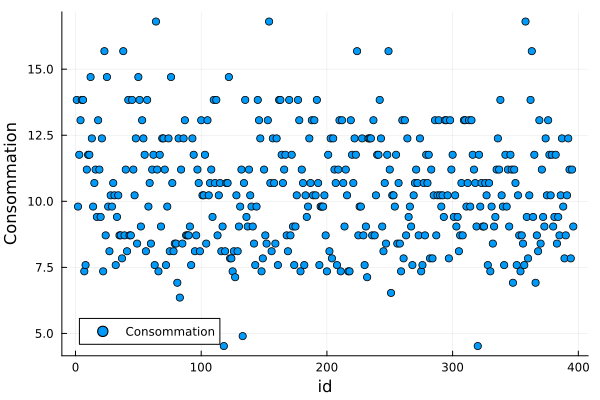

In [6]:
Plots.scatter(train_initial.consommation, label="Consommation", xlabel="id", ylabel="Consommation")


#### Analyse consommation moyenne


Dans l'analyse de la consommation, nous remarquons que plus de 90 % des données se situent entre 7.5 et 15. Aux extrêmes, nous identifions trois véhicules ayant une consommation inférieure à 5, tandis que 8 véhicules ont une consommation supérieure à 15. Il sera important d'identifier correctement ces véhicules afin de s'assurer qu'il ne s'agit pas de données aberrantes.

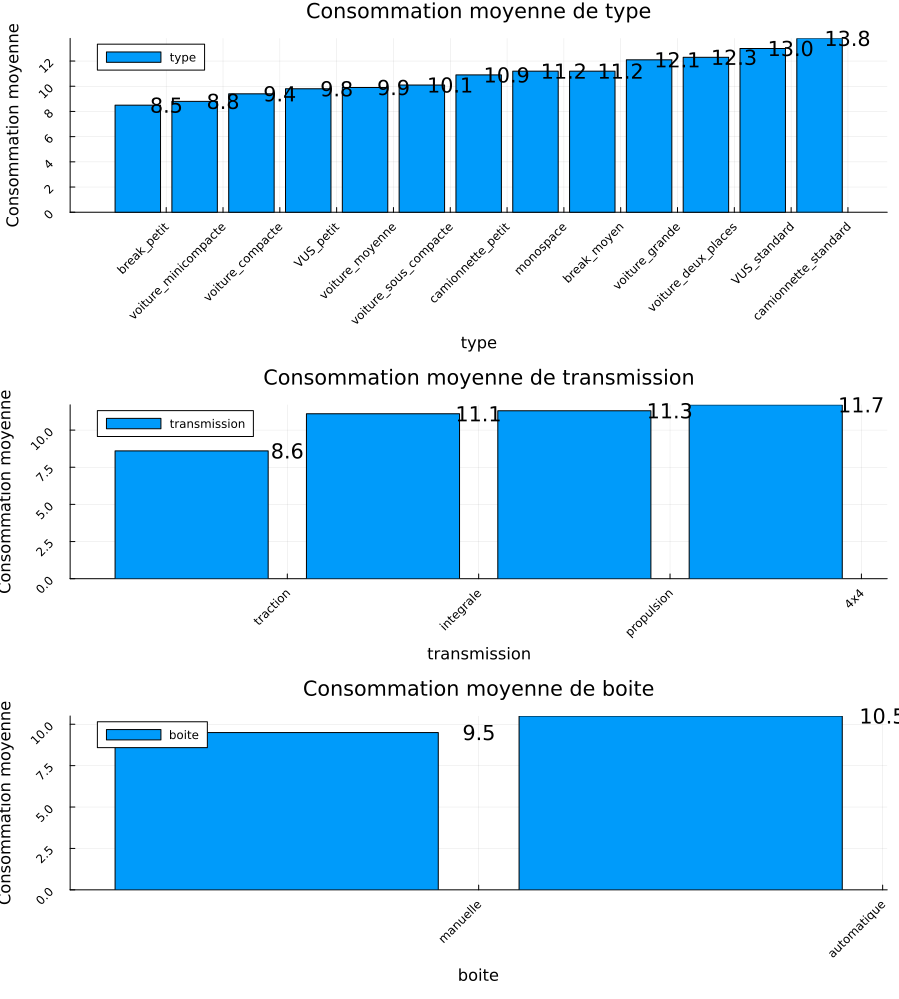

In [7]:
# Consommation moyenne par catégorie
function get_average_consumption_by_category(df, category)
    unique_vals = unique(df[!, category])
    mean_consumption = Dict{String, Float64}()
    for val in unique_vals
        mean_consumption[val] = mean(df[df[!, category] .== val, :consommation]) 
    end
    sorted_consumption = sort(collect(mean_consumption), by=x -> x[2])
    return sorted_consumption
end

function plot_average_consumption_by_category(df, category)
    sorted_consumption = get_average_consumption_by_category(df, category)
    df = DataFrame(car_type=collect(map(x -> x[1], sorted_consumption)), 
               value=collect(map(x -> x[2], sorted_consumption)))
    df.value = round.(df.value, digits=1)
    return Plots.bar(df.car_type, df.value, title="Consommation moyenne de $category", label="$category",
    xlabel="$category", ylabel="Consommation moyenne", seriestype=:bar, 
    xticks=(1:length(df.car_type), df.car_type), legend=:topleft, rotation=45,
    size=(800, 600), annotations=(1:length(df.car_type), df.value, string.(df.value)))
end

bar_type = plot_average_consumption_by_category(train_initial, :type)
bar_transmission = plot_average_consumption_by_category(train_initial, :transmission)
bar_boite = plot_average_consumption_by_category(train_initial, :boite)

display_array = [bar_type, bar_transmission, bar_boite]

Plots.plot(display_array...,  layout = (length(display_array), 1))
Plots.plot!(size=(900,1000))


Grâce aux graphiques précédents, nous avons pu tirer plusieurs renseignements importants. Tout d'abord, nous observons une **relation linéaire** entre la taille des véhicules et leur consommation moyenne d'essence. En effet, plus un véhicule est petit, moins il consomme d'essence, tandis qu'un véhicule plus grand consomme davantage. De plus, il apparaît que les transmissions à traction consomment en moyenne moins d'essence que les autres types de transmission. Enfin, sans surprise, le type de boîte joue également un rôle : une voiture équipée d'une boîte manuelle consomme en moyenne moins d'essence qu'une voiture automatique.



#### Analyse consommation aux fils des années

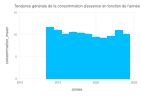

In [8]:
mean_consumption_by_year = combine(groupby(train_initial, :annee), :consommation => mean)
p = Gadfly.plot(mean_consumption_by_year, 
                x = :annee,
                y = :consommation_mean,
                Geom.line, 
                Geom.bar, 
                Guide.title("Tendance générale de la consommation d'essence en fonction de l'année"),
                )
display(p)


Dans ce graphique, nous observons que la consommation moyenne d’essence en fonction de l’année du véhicule reste relativement stable au fil des années.


#### Analyse fréquence des éléments

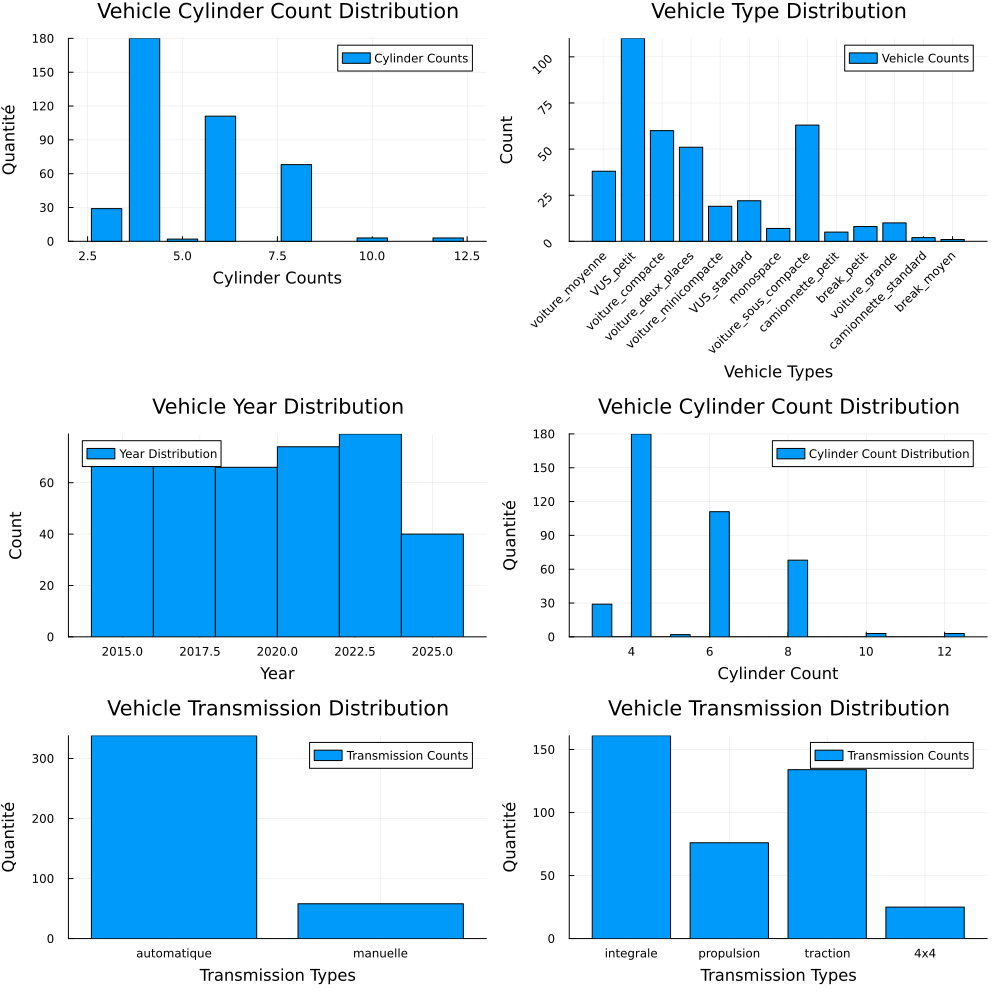

In [9]:
# Affichage des histogrammes pour chaque colonnes
function count_by_category(df, col)
    unique_vals = unique(df[!,col])
    counts = []
    for val in unique_vals
        push!(counts, sum(df[!,col] .== val))
    end
    return unique_vals, counts
end


bar_type = Plots.bar(count_by_category(train_initial, :type), label = "Vehicle Counts", xlabel = "Vehicle Types", ylabel = "Count", 
               legend = :topright, title = "Vehicle Type Distribution", xticks = :all, rotation = 45)


bar_cylinders = Plots.bar(count_by_category(train_initial, :nombre_cylindres)..., label = "Cylinder Counts", xlabel = "Cylinder Counts", 
                    ylabel = "Quantité", legend = :topright, title = "Vehicle Cylinder Count Distribution", xticks = :all)

hist_year = Plots.histogram(train_initial.annee, label = "Year Distribution", xlabel = "Year", ylabel = "Count", 
                      legend = :topleft, title = "Vehicle Year Distribution", xticks = :all)

hist_cylinders = Plots.histogram(train_initial.nombre_cylindres, label = "Cylinder Count Distribution", xlabel = "Cylinder Count", 
                           ylabel = "Quantité", legend = :topright, title = "Vehicle Cylinder Count Distribution", xticks = :all)

bar_boite = Plots.bar(count_by_category(train_initial, :boite)..., label = "Transmission Counts", xlabel = "Transmission Types", 
                ylabel = "Quantité", legend = :topright, title = "Vehicle Transmission Distribution", xticks = :all)

bar_transmission = Plots.bar(count_by_category(train_initial, :transmission)..., label = "Transmission Counts", xlabel = "Transmission Types",
                          ylabel = "Quantité", legend = :topright, title = "Vehicle Transmission Distribution", xticks = :all)

Plots.plot(bar_cylinders, bar_type, hist_year, hist_cylinders, bar_boite, bar_transmission, layout = (3, 2))

Plots.plot!(size=(1000,1000))


Les graphiques présentés offrent une vue d'ensemble des différentes caractéristiques des véhicules analysés dans l'ensemble de données.

Le premier graphique en haut à gauche illustre la répartition des nombres de cylindres par véhicule. Nous observons que la majorité des véhicules sont équipés de 4 cylindres, suivis par ceux à 6 cylindres. Les véhicules ayant 8 cylindres ou plus sont beaucoup plus rares, ce qui est cohérent avec la distribution typique de cylindres dans les voitures, où les moteurs plus grands sont moins fréquents.

Le deuxième graphique en haut à droite présente la distribution des types de véhicules. Les types les plus représentés sont les "VUS petit" et les "voitures compactes", tandis que les types moins courants incluent les camionnettes et les breaks moyens. Cela reflète probablement les préférences du marché pour des véhicules plus pratiques et compacts, adaptés à la vie urbaine.

Le troisième grahique au milieu à gauche montre la distribution des années des véhicules. On remarque que les données sont assez bien réparties entre 2015 et 2025, avec un léger pic pour les années les plus récentes (2022-2024). Cela suggère que les véhicules les plus récents sont légèrement surreprésentés, ce qui pourrait être dû à une actualisation des données ou à un intérêt accru pour les modèles récents.

Le quatrième grahique au milieu à droite répète la répartition des nombres de cylindres, confirmant les observations du premier graphique. Cette répartition met encore en avant la dominance des moteurs à 4 et 6 cylindres dans l'échantillon.

Le cinquième graphique, en bas à gauche, montre la distribution des types de boîtes de transmission. Il est évident que les véhicules automatiques dominent largement l'échantillon, représentant plus de 300 occurrences, tandis que les véhicules à transmission manuelle sont bien moins nombreux. Cette tendance est cohérente avec l'évolution des préférences des consommateurs, les transmissions automatiques étant devenues la norme dans de nombreux marchés en raison de leur commodité. Il faudra porter une attention particulière à la distribution des données entre le jeu d'entrainement et de validation afin de s'assurer que cette représentation des données est conservée.

Le sixème graphique, en bas à droite, analyse les différents types de transmission (intégrale, propulsion, traction, et 4x4). La transmission intégrale est la plus répandue, suivie de près par les véhicules à traction. En revanche, les véhicules à propulsion et ceux avec transmission 4x4 sont beaucoup moins nombreux. Cette distribution reflète probablement les caractéristiques pratiques des véhicules, où la traction et l’intégrale sont privilégiées pour une conduite plus stable et adaptée à diverses conditions routières.

Ces graphiques mettent en lumière des tendances importantes et aident à mieux comprendre les caractéristiques générales des véhicules présents dans le jeu de données, telles que la configuration des moteurs, les préférences pour certains types de véhicules, et la répartition des années de fabrication.


#### Analyse de la consommation par rapport à chaque variable

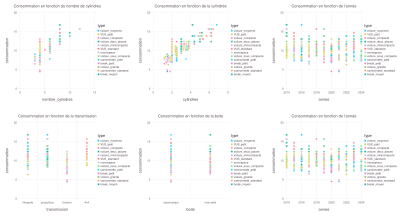

In [10]:
p1 = Gadfly.plot(train_initial, x=:nombre_cylindres, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction du nombre de cylindres"))
p2 = Gadfly.plot(train_initial, x=:cylindree, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction de la cylindrée"))
p3 = Gadfly.plot(train_initial, x=:annee, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction de l'année"))
p4 = Gadfly.plot(train_initial, x=:transmission, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction de la transmission"))
p5 = Gadfly.plot(train_initial, x=:boite, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction de la boite"))
p6 = Gadfly.plot(train_initial, x=:annee, y=:consommation, color=:type, Geom.point, Guide.title("Consommation en fonction de l'année"))

Gadfly.set_default_plot_size(40cm, 22cm)
display(vstack(hstack(p1, p2, p3), hstack(p4, p5, p6)))

#### Analyse de relations non-linéaires

Nous voulions ensuite tester des hypothèses de relations non-linéaires entre les variables numériques du problème.
Nous avons appliqué les fonctions de logarithme, racine carrée, et carrée sur la variable de cylindrée, puis avons tracé les consommations en fonction de ces nouvelles variables transformées.

R² = 0.6447504488678468, utilisation de cylindree, voitures manuelles
R² = 0.736481643329145, utilisation de cylindree_log, voitures manuelles
R² = 0.749799212744825, utilisation de cylindree, voitures automatiques
R² = 0.7568236351430941, utilisation de cylindree_sqrt, voitures automatiques


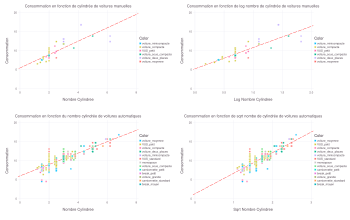

In [11]:
temp_df = deepcopy(train_initial)
temp_df[!, :cylindree_log] = log.(temp_df[:, :cylindree])
temp_df[!, :cylindree_sqrt] = sqrt.(temp_df[:, :cylindree])
temp_df[!, :cylindree_square] = (temp_df[:, :cylindree]).^2

temp_df_manuelle = filter(row -> row.boite == "manuelle", temp_df)
x = temp_df_manuelle[:,:cylindree]
y = temp_df_manuelle.consommation
type = temp_df_manuelle.type
n = length(y)
X = hcat(ones(n), x)
β̂ = X\y
Gadfly.set_default_plot_size(35cm, 22cm)
p1 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.Title("Consommation en fonction de cylindrée de voitures manuelles"), Guide.xlabel("Nombre Cylindree"), Guide.ylabel("Consommation"))

# Calcul et affichage du coefficient R^2
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree, voitures manuelles")

x = temp_df_manuelle[:,:cylindree_log]
X = hcat(ones(n), x)
β̂ = X\y

p2 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.Title("Consommation en fonction de log nombre de cylindrée de voitures manuelles"), Guide.xlabel("Log Nombre Cylindree"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_log, voitures manuelles")

temp_df_automatique = filter(row -> row.boite == "automatique", temp_df)
x = temp_df_automatique[:,:cylindree]
y = temp_df_automatique.consommation
n = length(y)
X = hcat(ones(n), x)
type = temp_df_automatique.type
β̂ = X\y
p3 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.Title("Consommation en fonction du nombre cylindrée de voitures automatiques"), Guide.xlabel("Nombre Cylindree"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree, voitures automatiques")

x = temp_df_automatique[:,:cylindree_sqrt]
X = hcat(ones(n), x)
β̂ = X\y
p4 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash), 
Guide.Title("Consommation en fonction de sqrt nombe de cylindrée de voitures automatiques"), Guide.xlabel("Sqrt Nombre Cylindree"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_sqrt, voitures automatiques")


vstack(hstack(p1, p2), hstack(p3, p4))


Le premier rensiegnement tiré de cette analyse est que le type de relation entre la consommation et la cylindrée est dépendant des variables catégorielles, telle la transmission et la boîte notamment.

En effet, l'analyse portant sur toutes les voitures avec boîte manuelle semble indiquer que le logarithme de la cylindrée ($R^2 = 0.736$) explique mieux la consommation que la cylindrée prise linéairement ($R^2 = 0.645$).
Dans le cas des voitures automatiques, l'application d'une racine carrée offre un ajustement légèrement meilleur. La figure contenant les voitures automatique à traction montre que la relation linéaire a un meilleur ajustement $R^2 = 0.757$, par rapport à une relation logarithmique dont le coefficient est $0.750$.
Cependant la différence est minime, donc la relation linéaire semble plus pertinente, notamment si l'on filtre encore par transmission.

La relation entre le carré de la cylindrée et la consommation, quant à elle, est presque toujours moins significatif qu'une relation linéaire, donc nous les avons laissé de côté pour la suite de l'analyse.

Cette analyse était très intéressante pour la sélection de variables qui viendra lors de la section sur le choix de modèle de prédiciton, car elle permet de déduire que l'impact de la cylindrée sur la consommation est dépendant des catégories de voitures. Ce ne sont donc pas seulement les coefficients de la régression qui sont affectés, mais même l'allure de la tendance comme nous avons vu entre l'analyse linéaire, logarithmique et racine carrée.


#### Analyse de relations composées

Ensuite, cette même analyse est reproduite pour une composition de variables explicatives.
Ici nous essayons le produit de la cylindrée par le nombre de cylindres.

R² = 0.7143007757243569, utilisation de cylindree_nombre_cylindres_product
R² = 0.7543517772573715, utilisation de cylindree_nombre_cylindres_product_log
R² = 0.7533880659072266, utilisation de cylindree_nombre_cylindres_product_sqrt
R² = 0.5675876454147448, utilisation de cylindree_nombre_cylindres_product_square


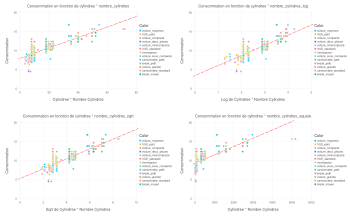

In [12]:
temp_df[!, :cylindree_prod] = temp_df[:, :cylindree] .* temp_df[:, :nombre_cylindres]
temp_df[!, :cylindree_prod_log] = log.(temp_df[:, :cylindree_prod])
temp_df[!, :cylindree_prod_sqrt] = sqrt.(temp_df[:, :cylindree_prod])
temp_df[!, :cylindree_prod_square] = (temp_df[:, :cylindree_prod]).^2


y = temp_df.consommation
type = temp_df.type
n = length(y)

x = temp_df[:,:cylindree_prod]
X = hcat(ones(n), x)
β̂ = X\y
Gadfly.set_default_plot_size(35cm, 22cm)
p5 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.title("Consommation en fonction de cylindree * nombre_cylindres"), Guide.xlabel("Cylindree * Nombre Cylindres"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_nombre_cylindres_product")

x = temp_df[:,:cylindree_prod_log]
X = hcat(ones(n), x)
β̂ = X\y
p6 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.title("Consommation en fonction de cylindree * nombre_cylindres_log"), Guide.xlabel("Log de Cylindree * Nombre Cylindres "), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_nombre_cylindres_product_log")


x = temp_df[:,:cylindree_prod_sqrt]
X = hcat(ones(n), x)
β̂ = X\y
p7 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.title("Consommation en fonction de cylindree * nombre_cylindres_sqrt"), Guide.xlabel("Sqrt de Cylindree * Nombre Cylindres"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_nombre_cylindres_product_sqrt")


x = temp_df[:,:cylindree_prod_square]
X = hcat(ones(n), x)
β̂ = X\y
p8 = Gadfly.plot(x=x, y=y, color=type, Geom.point, intercept = [β̂[1]], slope = [β̂[2]], Geom.abline(color="red", style=:dash),
 Guide.title("Consommation en fonction de cylindree * nombre_cylindres_square"),
 Guide.xlabel("Cylindree * Nombre Cylindres"), Guide.ylabel("Consommation"))
R² = 1 - sum((y - X*β̂).^2) / sum((y .- mean(y)).^2)
println("R² = $R², utilisation de cylindree_nombre_cylindres_product_square")

vstack(hstack(p5, p6), hstack(p7, p8))

L'essai avec la variable composée du produit de la cylindrée avec le nombre de cylindres est tiré d'une intuition que nous voulions tester. Celle-ci vient de l'hypothèse que le nombre de cylindres multiplié par la cylindrée donnerait le volume total d'essence contenue dans les cylindres d'une voiture.

Cependant nos tests précédents n'ont pas donné un coefficient $R^2$ significativement meilleur que l'utilisation de la cylindrée seule, à part pour certaines catégories comme les voitures à boîtes manuelles. Nous n'avons donc pas retenu cette composition de variables pour nos modèles principaux essayés plus loin dans le rapport, comme la régression linéaire.

### Définition des fonctions utilitaires

Le code ci-dessous contient des fonctions utilitaires pour le pré-traitement des données. Notamment, on y retrouve `one_hot_encode` qui consiste à transformer en un format numérique en créant une colonne binaire pour chaque catégorie. De plus, la fonction `normalize_data` applique une normalisation du score Z à chaque colonne numérique, afin de garantir une même échelle à travers le jeu de données. Ultimement, on retrouve `label_encode` qui consiste en une méthode alternative pour encoder les variables catégorielles en format numérique. Cette transformation se fait par le biais d'un dictionnaire d'encodage prédéfini. Contrairement à `one_hot_encode`, `label_encode` ne crée aucune colonne additionnelle et vient plutôt remplacer les colonnes d'origine.

In [13]:
# Encodage des variables non-numériques, par catégorie
function one_hot_encode(init_df, cols_to_encode)
    df = deepcopy(init_df)
    for col in cols_to_encode
        df[!, col] = categorical(df[!, col])
        dummies = select(df, Not(col))
        dummy_names = unique(levels(df[!, col]))
        for dummy in dummy_names
            new_col = Symbol(col, "_", dummy)
            df[!, new_col] = Int.(df[!, col] .== dummy)
        end
        select!(df, Not(col))
    end
    return df
end

function normalize_data(train_initial_df, train_raw_df, val_raw_df, test_initial_df)
    train_normalized_df = deepcopy(train_raw_df)
    val_normalized_df = deepcopy(val_raw_df)
    test_normalized_df = deepcopy(test_initial_df)
    for col in names(train_initial_df)
        if eltype(train_initial_df[!, col]) <: Number && col != :"consommation"
            println("Normalizing column $col")
            train_normalized_df[!, col] = (train_raw_df[:, col] .- mean(train_initial_df[:, col])) ./ std(train_initial_df[:, col])
            val_normalized_df[!, col] = (val_raw_df[:, col] .- mean(train_initial_df[:, col])) ./ std(train_initial_df[:, col])
            test_normalized_df[!, col] = (test_initial_df[:, col] .- mean(train_initial_df[:, col])) ./ std(train_initial_df[:, col])            
        end
    end
    return train_normalized_df, val_normalized_df, test_normalized_df
end

function label_encode(initial_df, cols_to_encode, encoding_dictionaries)
    df = deepcopy(initial_df)
    for (i, col) in enumerate(cols_to_encode)
        df[!, col] = map(x -> encoding_dictionaries[i][x], df[!, col])
    end
    return df
end

columns_to_encode = ["type", "transmission", "boite"]
encoding_dictionaries = [Dict("break_petit" => "1", "voiture_minicompacte" => "1", "voiture_compacte" => "2", "VUS_petit" => "2", "voiture_moyenne" => "2", "voiture_sous_compacte" => "2", "camionnette_petit" => "3", "monospace" => "3", "break_moyen" => "3", "voiture_grande" => "4", "voiture_deux_places" => "4", "VUS_standard" => "4", "camionnette_standard" => "4"), Dict("traction" => "1", "integrale" => "2", "propulsion" => "2", "4x4" => "2"), Dict("automatique" => "1", "manuelle" => "2")]

3-element Vector{Dict{String, String}}:
 Dict("break_moyen" => "3", "VUS_standard" => "4", "voiture_minicompacte" => "1", "voiture_compacte" => "2", "voiture_moyenne" => "2", "monospace" => "3", "camionnette_standard" => "4", "camionnette_petit" => "3", "voiture_deux_places" => "4", "voiture_grande" => "4"…)
 Dict("4x4" => "2", "propulsion" => "2", "integrale" => "2", "traction" => "1")
 Dict("manuelle" => "2", "automatique" => "1")

### Préparation des données

Pour assurer un entraînement optimal du futur modèle, il est essentiel de diviser le jeu de données en deux parties: un ensemble d'entraînement et un ensemble de validation. L'ensemble d'entraînement est utilisé pour ajuster les paramètres du modèle, tandis que l'ensemble de validation permet d'évaluer la performance du modèle sur des données non vues pendant l'apprentissage. Ainsi, pour faire la division, nous utilisons la fonction `splitobs` de la librairie `MLUtils` et utilisons une répartition de 60% pour l'ensemble d'entraînement et 40% pour l'ensemble de validation.

Nous avons également analysé le DataFrame d'entraînement initial afin d'identifier de potentielles données manquantes. Après analyse, nous avons confirmé que les données à notre disposition ne présentait aucune valeur manquante; aucune action n'est donc nécessaire.


#### Retrait des données aberrantes

In [14]:
### Retirer les valeurs minimales et maximales de la consommation
train_initial_copy = deepcopy(train_initial)
println("Train initial", size(train_initial_copy))
sorted_train = sort(train_initial_copy, :consommation)

train_initial_no_outliers = sorted_train[2:end-1, :]
elements_retires = vcat(sorted_train[1:1, :], sorted_train[end-1:end, :])

train_initial_no_outliers = sorted_train[4:end-3, :]

println("Éléments retirés :")
println(elements_retires)
println("Train initial sans outliers", size(train_initial_no_outliers))

Train initial(396, 7)
Éléments retirés :
3×7 DataFrame
 Row │ annee  type                 nombre_cylindres  cylindree  transmission  boite        consommation 
     │ Int64  String31             Int64             Float64    String15      String15     Float64      
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────
   1 │  2020  voiture_compacte                    4        1.8  traction      automatique       4.52327
   2 │  2016  voiture_moyenne                     8        6.8  propulsion    automatique      16.8007
   3 │  2014  voiture_deux_places                 8        4.2  integrale     manuelle         16.8007
Train initial sans outliers(390, 7)


L'approche utilisée vise à retirer les valeurs extrêmes de la colonne "consommation" afin de limiter leur impact sur les analyses ou modèles ultérieurs. Pour commencer, les données de l'ensemble train_initial sont triées en ordre croissant en fonction de la colonne "consommation". Cela permet d'organiser les observations de manière à identifier facilement les valeurs les plus petites et les plus grandes. Une fois les données triées, les trois plus petites et les trois plus grandes valeurs de consommation sont considérées comme des outliers potentiels. Ces valeurs sont ensuite retirées de l'ensemble de données, en conservant uniquement les lignes situées entre la quatrième position et la troisième avant la fin, excluant ainsi les six valeurs extrêmes identifiées. Les valeurs retirées sont stockées dans une variable distincte appelée elements_retires, ce qui permet de les analyser séparément ou de les utiliser pour vérifier leur légitimité en tant qu'outliers. Enfin, la nouvelle version de l'ensemble de données, nommée train_initial_no_outliers, est affichée avec sa taille réduite, et les éléments extrêmes retirés sont également présentés pour assurer transparence et traçabilité. Cette approche est une méthode simple mais efficace pour réduire l'influence des valeurs aberrantes, bien qu'elle repose sur un choix arbitraire (les trois plus petites et trois plus grandes valeurs), qui pourrait être ajusté ou complété par d'autres critères, comme l'utilisation des intervalles interquartiles (IQR), selon le contexte d'analyse. 

Les résultats obtenus plus bas dans le code montrent une dégradation des performances du modèle, car le RMSE a considérablement augmenté. Ce phénomène indique que le modèle ne parvient pas à faire des prédictions précises sur les données de validation, ce qui peut être dû à plusieurs facteurs. L'élimination des valeurs extrêmes, bien qu'elles puissent réduire l'impact de certaines données aberrantes, a probablement entraîné la suppression de points de données importants qui aidaient le modèle à mieux comprendre les relations entre les variables. En supprimant ces valeurs, le modèle pourrait avoir perdu des informations cruciales sur certaines variations naturelles des données. Une autre cause potentielle pourrait être une mauvaise configuration des hyperparamètres, qui peut rendre le modèle plus sensible aux fluctuations des données après le retrait des données aberrantes. Pour améliorer les résultats, plusieurs pistes peuvent être explorées. D'abord, au lieu d'éliminer un nombre fixe de valeurs extrêmes, une approche basée sur des méthodes statistiques comme l'utilisation de l'écart interquartile (IQR) ou un seuil de z-score pourrait être plus robuste. Cela permettrait de détecter et de supprimer les valeurs aberrantes de manière plus flexible et moins rigide. Une autre solution serait d'explorer l'ajustement des hyperparamètres du modèle, notamment la régularisation, afin de rendre le modèle plus résistant aux variations extrêmes tout en maintenant une bonne capacité de généralisation.

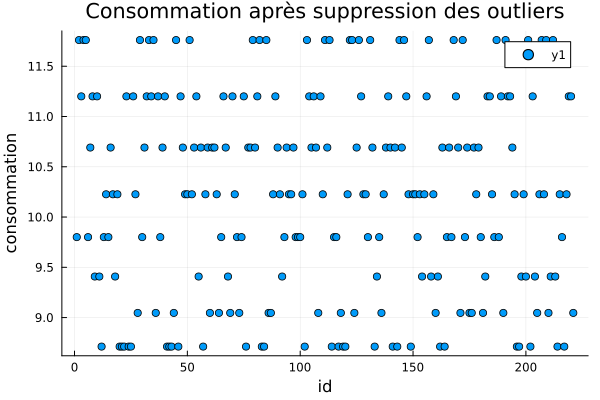

In [15]:
train_initial_copy = deepcopy(train_initial)
q1 = quantile(train_initial_copy.consommation, 0.40)
q3 = quantile(train_initial_copy.consommation, 0.60)
interquartile_range = q3 - q1

lower_bound = q1 - 1.5 * interquartile_range
upper_bound = q3 + 1.5 * interquartile_range
train_initial_copy = filter(row -> (row.consommation >= lower_bound && row.consommation <= upper_bound), train_initial_copy)

Plots.scatter(train_initial_copy.consommation, xlabel="id", ylabel="consommation", title="Consommation après suppression des outliers")


Sachant l'analyse précédente, nous avons réessayé de supprimé les données aberrantes sur la base d'une analyse des quartiles, afin de garantir une meilleur qualité de notre jeu de données.

#### Création d'ensembles d'entraînement et de validation

Les données sont séparées en ensembles d'entraînement et de validation, puis mélangées afin d'assurer une répartition uniforme des différentes catégories.

In [16]:
shuffled_train = copy(train_initial)
shuffle!(shuffled_train)
split_ratio = 0.6
train_raw, val_raw = splitobs(shuffled_train, at=split_ratio)
train_raw = DataFrame(train_raw)
val_raw = DataFrame(val_raw);

In [17]:
# Vérifier la présence de valeurs manquantes
missing_values_summary = describe(train_initial, :nmissing)
println(missing_values_summary)

7×2 DataFrame
 Row │ variable          nmissing 
     │ Symbol            Int64    
─────┼────────────────────────────
   1 │ annee                    0
   2 │ type                     0
   3 │ nombre_cylindres         0
   4 │ cylindree                0
   5 │ transmission             0
   6 │ boite                    0
   7 │ consommation             0


### Normaliser les données + Encodage

Dans le code ci-dessous, nous procédons à la normalisation et à l'encodage des données des ensembles d'entraînement, de validation et de test à l'aide des fonctions utilitaires mentionnées précédemment. Les résultats sont ensuite stockés dans trois DataFrames distincts: `train_normalized`, `val_normalized` et `test_normalized`.

In [18]:
### Normaliser les données
train_normalized, val_normalized, test_normalized = normalize_data(train_initial, train_raw, val_raw, DataFrame(test_initial))

train = DataFrame(label_encode(train_normalized, columns_to_encode, encoding_dictionaries))
val = DataFrame(label_encode(val_normalized, columns_to_encode, encoding_dictionaries))
test = DataFrame(label_encode(test_normalized, columns_to_encode, encoding_dictionaries));


Normalizing column annee
Normalizing column nombre_cylindres
Normalizing column cylindree


### Analyse de corrélation et multi-colinéarité

#### Matrice de corrélation

La matrice de corrélation ci-dessous permet de mieux comprendre la relation entre les variables du modèle et d'identifier les variables fortement corrélées entre elles. 

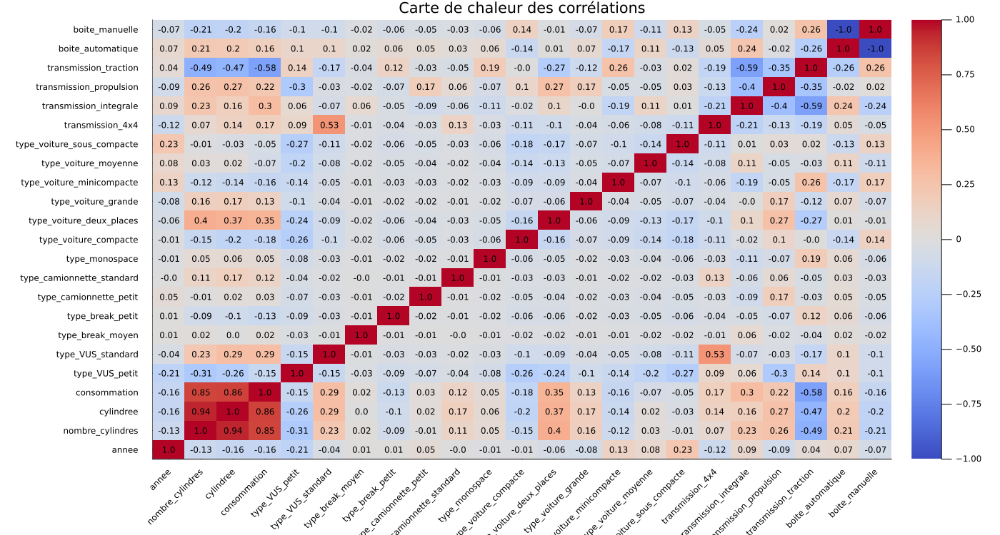

In [19]:
analysis_df = one_hot_encode(deepcopy(train_initial), columns_to_encode)
cor_matrix = cor(Matrix(analysis_df))
heat = Plots.heatmap(cor_matrix, 
    title = "Carte de chaleur des corrélations",
    xrotation = 45,
    color = :coolwarm,
    xlabel = "Attributs", ylabel = "Attributs",
    xticks = (1:size(analysis_df, 2), names(analysis_df)),
    yticks = (1:size(analysis_df, 2), names(analysis_df))
)
for i in 1:size(cor_matrix, 1)
    for j in 1:size(cor_matrix, 2)
        annotate!(j, i, (round(cor_matrix[i, j], digits=2), :black, 8))
    end
end
plot!(size=(1400,750))
display(heat)


On constate que les variables ci-dessous sont fortement corrélées entre elles:
- `consommation` et `nombre_cylindres`: 0.85 
- `consommation` et `cylindree`: 0.86
- `cylindree` et `nombre_cylindres`: 0.94

Cela nous indique que `nombre_cylindres` et `cylindree` pourraient être de bon prédicteurs pour la variable d'intérêt de consommation. Cependant, la forte corrélation entre `cylindree` et `nombre_cylindres` de 0.94 pourrait indiquer une potentielle multicolinéartié entre les variables qui pourrait causer de l'instabilité dans les coefficients de régression du modèle et de la perte de robustesse dans nos prédictions. Nous allons donc étudier plus en détail avec le facteur d'inflation de la variance (VIF).


#### Détection de multicolinéarité avec VIFs

Le calcul des facteurs d'inflation de la variance (VIF) nous permettra de détecter la présence de multicolinéarité entre les variables explicatives du modèle. 

Afin de pouvoir faire ce calcul, on exclut: 
- la variable d'intérêt (mesure de multicolinéarité entre les variables explicatives seulement)
- une colonne de chaque variable encodée en one-hot pour éviter d'obtenir des VIFs=Inf (dépendance linéaire dû à l'encodage one-hot qui donne R² = 1)

In [20]:
function calculate_vif(dependent, independents, data)
    formula = Term(dependent) ~ sum(Term(independent) for independent in independents)
    model = lm(formula, data)
    return 1 / (1 - r2(model))
end

excluded_columns = [:consommation, :type_VUS_petit, :transmission_4x4, :boite_manuelle]
features = setdiff(propertynames(analysis_df), excluded_columns)

vifs = Dict()

for feature in features
    other_features = setdiff(features, [feature])
    vifs[feature] = calculate_vif(feature, Symbol.(other_features), analysis_df)
end

println("Facteurs d'inflation de la variance :")
for (feature, vif) in vifs
    println("$feature: $vif")
end

Facteurs d'inflation de la variance :
annee: 1.2324057484203321
type_monospace: 1.1419526771580295
type_voiture_compacte: 1.5609325586163196
type_voiture_grande: 1.2116203631885798
type_break_petit: 1.082371407580124
type_break_moyen: 1.0154999769862998
transmission_propulsion: 4.883336990454498
boite_automatique: 1.2588554292153853
type_voiture_sous_compacte: 1.6945942804071092
transmission_traction: 6.407022289682124
type_VUS_standard: 1.7126982018278216
type_voiture_minicompacte: 1.3169471158522692
cylindree: 11.265280756541562
type_camionnette_standard: 1.121191394686272
type_voiture_moyenne: 1.3349051565942929
type_voiture_deux_places: 1.9352381316854979
type_camionnette_petit: 1.1215038961595334
transmission_integrale: 6.515379801503906
nombre_cylindres: 11.065833302944807


Les variables `annee`, `type`, `transmission`, et `boite` ont des VIF inférieurs à 2, ce qui indique une faible multicolinéarité. Elles ne posent pas de problème significatif dans le modèle.

Les variables `cylindree` et `nombre_cylindres` ont des valeurs de VIF > 10 indiquant une forte multicolinéarité. Cela signifie qu'elles sont fortement corrélées avec d'autres variables explicatives, ce qui peut entraîner une instabilité des coefficients de régression. Une action est donc nécessaire pour réduire leur impact sur le modèle.

#### Analyse en composantes principales


Il est pertinent de réaliser une analyse en composantes principales afin de réduire la dimensionnalité d'un jeu de données tout en conservant au maximum l'information essentielle. Dans le code suivant, cette analyse est mise en oeuvre en commençant par appliquer la fonction utilitaire `one_hot_encode` pour convertir les variables catégorielles en un format numérique adapté aux calculs mathématiques sur la matrice `mtrx`. L'analyse en composantes principales est ensuite calculée sur cette matrice. Puis, on calcule la variance cumulée en additionnant les variances expliquées par chacune des composantes principales. Ce résultat permet d'identifier le nombre optimal de composantes principales, représenté par `maxoutdim`, en fonction du seuil défini par `variance_threshold_to_capture`. On recalcule ensuite l'analyse en composantes principales en se limitant au nombre optimal de composantes principales `maxoutdim` et on projette les données de la matrice `mtrx` dans l'espace des composantes principales définies par le modèle résultant de l'analyse en composantes principales.

In [21]:
variance_threshold_to_capture = 95
mtrx = Matrix(one_hot_encode(train, columns_to_encode))
pca_model = fit(PCA, mtrx)
explained_variance = pca_model.prinvars ./ sum(pca_model.prinvars) * 100
cumulative_variance = cumsum(explained_variance)
maxoutdim = findfirst(x -> x >= variance_threshold_to_capture, cumulative_variance)
pca_model = fit(PCA, mtrx; maxoutdim=maxoutdim)
pca_scores = MultivariateStats.transform(pca_model, mtrx)
println("Nombre de composantes principales sélectionnées : $maxoutdim")
println("Variance expliquée cumulée : $(cumulative_variance[maxoutdim]) %")

Nombre de composantes principales sélectionnées : 1
Variance expliquée cumulée : 97.22356420629933 %



En analysant nos résultats, la méthode d'analyse en composantes principales révèle qu'une seule composante principale est suffisante pour expliquer la quasi-totalité de la variance des données, indiquant une forte multicolinéarité. Cette analyse s'avère donc une solution efficace pour traiter la multicolinéarité observée notamment entre les colonnes `cylindree` et `nombre_cylindres` de notre jeu de données, en permettant de réduire ces variables, entre autres, en une seule composante principale.


### Modèles de prédiction

#### Régression linéaire simple


Nous avons d'abord tenté de d'ajuster les données sur un modèle de régression linéaire simple. Cette tentative est appuyée par le fait que l'on pouvait remarquer une tendance linéaire sur plusieurs graphiques lors de notre analyse des données.

Afin d'éviter de rater le meilleur modèle par un biais de notre part incrustré notre analyse des données, nous avons préféré tenter une régression avec chaque combinaison de variable explicative possible. Ceci est possible puisqu'il n'y a pas beaucoup de données d'entraînement et de variables explicatives, ce qui rend le temps de calcul nécessaire négligeable. 

Le code ci-dessous applique une régression linéaire simple sur toutes les combinaisons de variables explicatives et trie les résultats en ordre croissant de la racine de l'erreur quadratique moyenne (RMSE) calculée sur les données de validation.


In [22]:
# Génération de toutes les combinaisons de variables explicatives possibles
features = names(train[:, Not(:consommation)])
combs = [tuple(comb...) for k in 1:length(features) for comb in combinations(features, k)]
println(combs)

Tuple{String, Vararg{String}}[("annee",), ("type",), ("nombre_cylindres",), ("cylindree",), ("transmission",), ("boite",), ("annee", "type"), ("annee", "nombre_cylindres"), ("annee", "cylindree"), ("annee", "transmission"), ("annee", "boite"), ("type", "nombre_cylindres"), ("type", "cylindree"), ("type", "transmission"), ("type", "boite"), ("nombre_cylindres", "cylindree"), ("nombre_cylindres", "transmission"), ("nombre_cylindres", "boite"), ("cylindree", "transmission"), ("cylindree", "boite"), ("transmission", "boite"), ("annee", "type", "nombre_cylindres"), ("annee", "type", "cylindree"), ("annee", "type", "transmission"), ("annee", "type", "boite"), ("annee", "nombre_cylindres", "cylindree"), ("annee", "nombre_cylindres", "transmission"), ("annee", "nombre_cylindres", "boite"), ("annee", "cylindree", "transmission"), ("annee", "cylindree", "boite"), ("annee", "transmission", "boite"), ("type", "nombre_cylindres", "cylindree"), ("type", "nombre_cylindres", "transmission"), ("type", 

In [23]:
# Régression linéraire simple

models = []
for i in 1:length(combs)
    text = "consommation ~ " * join(combs[i], " + ")
    f = @eval(@formula($(Meta.parse(text))))
    M = lm(f, train)
    r2 = adjr2(M)

    ŷ = StatsBase.predict(M, val)
    rmse = sqrt(sum((val.consommation - ŷ).^2)/length(ŷ))
    push!(models, (r2, rmse, M))
end

models = sort(models, by=x -> x[2])
M = models[1][3]
println("Meilleur RMSE = ", models[1][2])
println("Meilleur modèle = ", models[1][3])

ŷ_lineaire = StatsBase.predict(M, val);


Meilleur RMSE = 1.0330869788711992
Meilleur modèle = StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, LinearAlgebra.CholeskyPivoted{Float64, Matrix{Float64}, Vector{Int64}}}}, Matrix{Float64}}

consommation ~ 1 + annee + type + nombre_cylindres + cylindree + transmission + boite

Coefficients:
─────────────────────────────────────────────────────────────────────────────────
                       Coef.  Std. Error      t  Pr(>|t|)   Lower 95%   Upper 95%
─────────────────────────────────────────────────────────────────────────────────
(Intercept)        9.64484     0.258651   37.29    <1e-98   9.1352     10.1545
annee             -0.0608058   0.0641975  -0.95    0.3446  -0.187299    0.0656874
type: 2            0.159235    0.262823    0.61    0.5452  -0.358626    0.677096
type: 3            0.760476    0.410884    1.85    0.0655  -0.0491206   1.57007
type: 4            0.118612    0.309192    0.38    0.7016  -0.490613    0.727838
nomb

On remarque ainsi que la meilleure combinaison est vraisemblablement celle qui inclue toutes les variables. Les prochaines tentatives non-linéaires présenteront potentiellement un résultat différent.

#### Régression polynomiale


Une autre initiative consiste à tester un modèle de régression polynomiale afin de détecter des relations qui pourraient avoir échappé à notre analyse initiale des données, laquelle avait uniquement révélé des tendances linéaires sur la base des différents graphiques générés. De manière similaire au code utilisé pour la régression linéaire simple, nous testons une régression polynomiale sur toutes les combinaisons de variables explicatives, en fonction d'un degré maximal spécifié correspondant à la variable `degree`. Puis, les résultats sont triés par ordre croissant de la valeur de la racine de l'erreur quadratique moyenne (RMSE) calculée sur l'ensemble de validation.


In [24]:
# Régression polynomiale

# Les variables catégorielles des ensembles d'entraînement et validation doivent être cast en Int64 pour effectuer des opérations mathématiques
train_copy = deepcopy(train)
train_copy.type = parse.(Int, train_copy.type)
train_copy.transmission = parse.(Int, train_copy.transmission)
train_copy.boite = parse.(Int, train_copy.boite)

val_copy = deepcopy(val)
val_copy.type = parse.(Int, val_copy.type)
val_copy.transmission = parse.(Int, val_copy.transmission)
val_copy.boite = parse.(Int, val_copy.boite)

# Pour préparer l'ensemble de tests, il faut également convertir les colonnes catégorielles en Int64
test_copy = deepcopy(test)
test_copy.type = parse.(Int, test_copy.type)
test_copy.transmission = parse.(Int, test_copy.transmission)
test_copy.boite = parse.(Int, test_copy.boite)

function generate_polynomial_formula(vars, degree)
    terms = []
    for var in vars
        for d in 1:degree
            push!(terms, "$(var)^$d")
        end
    end
    return join(terms, " + ")
end

degree = 3
models = []

for i in 1:length(combs)
    polynomial_terms = generate_polynomial_formula(combs[i], degree)
    text = "consommation ~ " * polynomial_terms
    f = @eval(@formula($(Meta.parse(text))))
    
    M = lm(f, train_copy)
    r2 = adjr2(M)

    ŷ_polynomial = StatsBase.predict(M, val_copy)
    rmse = sqrt(sum((val_copy.consommation - ŷ_polynomial).^2)/length(ŷ_polynomial))

    push!(models, (r2, rmse, M, f))
end

# Trier les modèles par RMSE
models = sort(models, by=x -> x[2])
M = models[1][3]
println("Best RMSE = ", models[1][2])

best_formula = formula(M)
features_used = termnames(best_formula.rhs)
println("Attributs utilisées dans le meilleur modèle : ", features_used)
ŷ_polynomial = StatsBase.predict(M, val_copy);

Best RMSE = 1.0042833978888515
Attributs utilisées dans le meilleur modèle : ["(Intercept)", "type ^ 1", "type ^ 2", "type ^ 3", "nombre_cylindres ^ 1", "nombre_cylindres ^ 2", "nombre_cylindres ^ 3", "cylindree ^ 1", "cylindree ^ 2", "cylindree ^ 3", "transmission ^ 1", "transmission ^ 2", "transmission ^ 3", "boite ^ 1", "boite ^ 2", "boite ^ 3"]


#### Régression Bayésienne

Nous avons choisi d'explorer la régression bayésienne pour comparer les prédictions obtenues à celle d'une régression linéaire classique. La régression bayésienne permet d'avoir plus de contrôle sur l'incertitude des paramètres du modèle. Cependant nous n'avons pas de connaissances préalables à exploiter pour choisir les lois a priori, nous avons donc testé plusieurs distributions en variant les paramètres afin d'identifier celles qui donnaient le meilleur RMSE.

**Choix des lois a priori**

1. Pour les coefficients **β** : Nous avons opté pour une loi normale multivariée centrée à zéro avec une variance de 2. Ce choix est basé sur l'idée que les coefficients β ne devraient pas trop s'écarter de zéro, tout en laissant une certaine flexibilité pour que les données les influencent.

2. Pour la variance **σ** : Nous avons utilisé une loi Inverse Gamma qui a l'avantage de toujours générer des valeurs strictement positives, ce qui est nécessaire pour représenter une variance. Les paramètres de cette loi (2,3) ont été ajustés pour refléter une incertitude initiale modérée sur σ.

La vraisemblance du modèle indique que chaque observation suit une distribution normale dont la moyenne est donnée par le produit scalaire Xβ et la variance est σ.

Certaines variables explicatives sont catégorielles (comme le type, la boite et la transmission) et ont donc été transformées en variables numériques exploitables dans la régression avec l'encodage One-Hot.

Nous avons utilisé l'algorithme NUTS (No-U-Turn Sampler), une version plus avancée de HMC (Hamiltonian Monte Carlo) pour effectuer un échantillonnage en exploitant les gradients de la fonction de vraisemblance pour guider les propositions de l'échantillonnage. NUTS améliore HMC en enlevant le besoin de régler manuellement certains hyperparamètres comme la longueur du chemin de simulation (leapfrog steps). Nous avons également testé avec l'algorithme de Gibbs et HMC: `Gibbs(HMC(0.05, 20, :β), HMC(0.05, 20, :σ))` mais cela donnait relativement les mêmes RMSE en plus de temps, donc nous avons décidé de garder NUTS.

Pour estimer les coefficients β, la moyenne des échantillons de la chaîne MCMC pour chaque βi est calculée. Cela donne une estimation ponctuelle des coefficients qui est ensuite utilisée pour effectuer des prédictions sur les nouvelles données.


In [25]:
@model function bayesian_linear_regression(X, y)
    # Loi a priori pour les coefficients de regression et la variance
    β ~ MvNormal(zeros(size(X, 2)), 2)
    σ ~ InverseGamma(2, 3)

    # Vraisemblance
    for i in 1:length(y)
        value =  reshape(X[i, :], 1, :) * β
        y[i] ~ Normal(value[1], σ)
    end
end

# Encodage One-Hot de type, transmission et boite
train_encoded = one_hot_encode(DataFrame(deepcopy(train)), [:type, :transmission, :boite])
val_encoded = one_hot_encode(DataFrame(deepcopy(val)), [:type, :transmission, :boite])
test_encoded = one_hot_encode(DataFrame(deepcopy(test)), [:type, :transmission, :boite])

# Creation des matrices contenant les variables explicative pour le modèle
X_train = hcat(ones(nrow(train_encoded)), Matrix(train_encoded[:, Not(:consommation, :nombre_cylindres)]))
X_val = hcat(ones(nrow(val_encoded)), Matrix(val_encoded[:, Not(:consommation, :nombre_cylindres)]))
X_test = hcat(ones(nrow(test_encoded)), Matrix(test_encoded[:, Not(:nombre_cylindres)]))

y_train = train.consommation;

# Création du modèle bayésien
model = bayesian_linear_regression(X_train, y_train)

# Échantillonnage
println("Démarrage de l'échantillonnage de la régression linéaire bayésienne...")
chain = sample(model, NUTS(), 1000; progress=true)
println("Échantillonnage complété!") 

# Prédiction
β_means = [mean(chain[string("β[", i, "]")]) for i in 1:size(X_train, 2)]
ŷ_bayesian = X_val * β_means;


Démarrage de l'échantillonnage de la régression linéaire bayésienne...


┌ Info: Found initial step size
└   ϵ = 0.003125
Sampling: 100%|█████████████████████████████████████████| Time: 0:00:13


Échantillonnage complété!


#### Random Forest


En bonus, nous avons décidé de tenter un modèle de type Random Forest, que nous avons étudié lors du dernier chapitre sur la classification bayésienne.

In [26]:
using DecisionTree

train[!, :multiplication_cylindre] = train[!, :nombre_cylindres] .* train[:, :cylindree]

val[!, :multiplication_cylindre] = val[!, :nombre_cylindres] .* val[:, :cylindree]

test[!, :multiplication_cylindre] = test[!, :nombre_cylindres] .* test[:, :cylindree]

features  = [:multiplication_cylindre, :nombre_cylindres, :cylindree, :transmission, :boite]
target = :consommation

X = Matrix(train[:, features])
y = train[:, target]
val_X = Matrix(val[:, features])
test_X = Matrix(test[:, features])

sub_feature = length(features)
n_trees = 50
min_samples_leaf = 1
min_samples_split = 5
max_features = size(X, 2)
min_purity_increase = 0.0001
max_depth = 20
partial_sampling = float(1)

forest = build_forest(y, X, sub_feature, n_trees, partial_sampling, max_depth, min_samples_leaf, min_samples_split, min_purity_increase)

ŷ_random_forest = apply_forest(forest, val_X)

158-element Vector{Float64}:
 12.875981827702379
 11.760794749373435
  9.50236241155379
 12.875981827702379
  9.50236241155379
  9.50236241155379
 10.89534194448146
  7.600458483064182
  7.348645710953023
 12.875981827702379
  9.50236241155379
 11.760794749373435
 13.171995992145378
  ⋮
  7.600458483064182
  9.50236241155379
 10.89534194448146
 10.516005251536141
 13.060095259431236
  7.882527389974223
 12.930089797630764
 10.89534194448146
  9.747307962980903
  8.66527216262146
  7.191355561043755
 10.516005251536141


Le code présenté implémente un modèle de Random Forest en Julia à l'aide de la bibliothèque DecisionTree. Un Random Forest est un ensemble d'arbres décisionnels construits sur des sous-échantillons aléatoires de données et de caractéristiques, et ces prédictions combinent les résultats de ces arbres (par moyenne dans le cas de la régression ou par vote majoritaire pour la classification). Ce modèle est robuste et réduit le risque de surapprentissage en diversifiant les arbres.

Dans ce code, plusieurs paramètres sont configurés pour la construction de la forêt. Par exemple, le nombre de caractéristiques sélectionnées aléatoirement pour chaque arbre est défini à la totalité des caractéristiques disponibles, tandis que la forêt est constituée de 50 arbres. Chaque feuille d’arbre doit contenir au moins un exemple, et une division de nœud nécessite un minimum de cinq exemples. La profondeur maximale des arbres est fixée à 20, ce qui autorise une forte complexité, et une augmentation minimale de la pureté de 0.0001 est requise pour effectuer une division, ce qui permet des découpages subtils des données. Enfin, tous les exemples disponibles (100 % des données) sont utilisés pour construire chaque arbre. Ce dernier point est particulièrement important, car le nombre de données fournies est relativement faible, ce qui limite notre capacité à en retirer une grande quantité de l'entrainement.

Nous avons utilisé la bibliothèque DecisionTree pour nous sauver du temps et nous concentrer davantage à trouver les hyperparamètres optimaux. Les hyperparamètres les plus efficaces ont été trouvés en effectuant ce qui est communément appelé en anglais le "grid search". Ceci permet de tester plusieurs combinaisons de paramètres afin de trouver la combinaison qui représente mieux le jeu de données de validation. 


### Évaluation des modèles de prédiction

#### Mesure de l'erreur

In [27]:
preds = [ŷ_lineaire, ŷ_polynomial, ŷ_random_forest, ŷ_bayesian]
pred_name = ["Lineaire", "Polynomial", "Random Forest", "Bayésien"]

for (pred, pred_name) in zip(preds, pred_name)
    print(pred_name, " : RMSE = ",sqrt(sum((val.consommation - pred).^2)/length(pred)), "\n")
end


Lineaire : RMSE = 1.0330869788711992
Polynomial : RMSE = 1.0042833978888515
Random Forest : RMSE = 1.0074408912101844
Bayésien : RMSE = 1.0463902736721002


#### Visualisation des prédictions

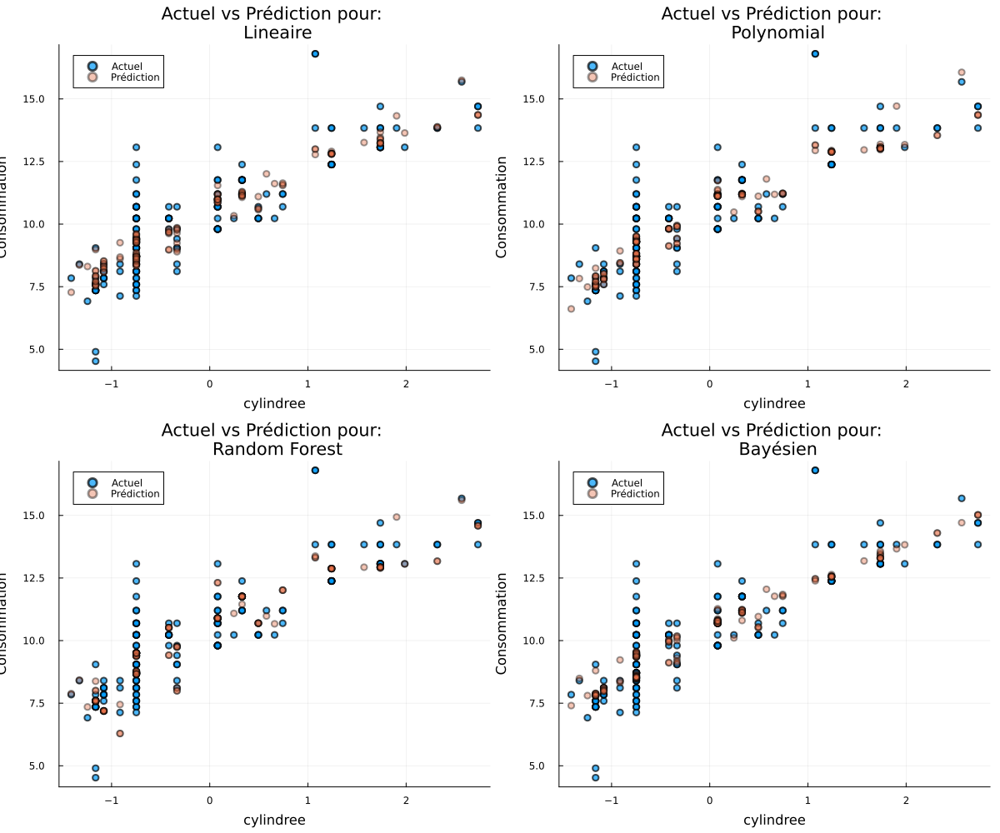

In [28]:
function visualize_predictions_by_variable(explicative_var)
    plots = []
    for (pred, pred_name) in zip(preds, pred_name)
        p = Plots.scatter(val[!, Symbol(explicative_var)], val.consommation, label="Actuel", xlabel=string(Symbol(explicative_var)), ylabel="Consommation", title="Actuel vs Prédiction pour: \n $pred_name", legend=true, alpha=0.7)
        Plots.scatter!(val[!, Symbol(explicative_var)], pred, label="Prédiction", markershape=:circle, alpha = 0.4)
        push!(plots, p)
    end


    display(Plots.plot(plots..., layout=(2, 2), size=(1200, 1000)))
end

visualize_predictions_by_variable("cylindree") # à change en fonction de la variable voulue

La fonction `visualize_predictions_by_variable` offre une visualisation des prédictions de chaque modèle en fonction d'une variable explicative. Elle permet non seulement de comparer les prédictions aux valeurs réelles de consommation, mais également d'évaluer la performance relative des différents modèles en fonction des cette variable. Par exemple, pour la variable *cylindrée*, on observe que les modèles de régression linéaire et bayésien ont des résultats très proches, tandis que le modèle polynomial s'écarte de manière importante des valeurs réelles. De plus, le modèle linéaire illustre bien une tendance générale avec une courbe nette, mais il reste éloigné de certaines observations. En revanche, le modèle Random Forest semble fournir des prédictions plus proches des valeurs réelles, indiquant une meilleure adaptation.

### Prédiction sur l'ensemble de test

In [29]:
fn = length(x)
ŷ = apply_forest(forest, test_X);

#### Création du fichier de prédictions

In [30]:
println("Nombre de rangées de test: ", nrow(test))
println("Nombre rangées de prédictions: ", length(ŷ))
n = nrow(test)
id = 1:n

df_pred = DataFrame(id=id, consommation=ŷ)

CSV.write("benchmark.csv", df_pred)

Nombre de rangées de test: 150
Nombre rangées de prédictions: 150


"benchmark.csv"

## Conclusion



Cette étude nous a permis d'explorer les relations entre les caractéristiques des véhicules et leur consommation moyenne, en identifiant des facteurs clés. Cette dernière section présente nos apprentissages, ainsi que les limites de notre méthodologie et améliorations potentielles.

**Lors de l'analyse de données**, les variables tels le type de transmission, la boîte de vitesses et la cylindrée se sont démarquées comme déterminantes pour prédire la consommation. Cependant certaines variables étaient plus difficiles à prendre en compte, comme les types de voitures dont les nombres de données étaient très déséquilibrés.

De plus, l’exploration des relations linéaires et non linéaires a permis d'affiner notre compréhension des interactions entre les variables.

Nous avons également pu étudier la corrélation et de multicolinéarité dans les données. qui a montré la présence de relations fortes entre certaines variables, comme le nombre de cylindres et la cylindrée.


Ces apprentissages ont guidé **les tests de modèles de prédiction**, notamment dans la sélection des modèles prédictifs et l'évaluation de leur efficacité.

**Limites**

La multicolinéarité ayant été importante entre certaines variables, l’utilisation de techniques comme l’analyse en composantes principales aurait pu améliorer la qualité de nos modèles. Les relations non linéaires n'ont également pas été très bien exploitées dans nos modèles, même si l'analyse semblait prometteuse.


**Améliorations possibles**

Certaines pistes non explorées pourraient améliorer nos modèles. Notamment nous n'avons pas exploré des lois multiples, même si elles auraient pu être pertinent pour une meilleur utilisation de la variable des types de voitures. De plus, notre essai de régression bayésienne aurait pu être amélior avec un meilleur choix de loi a priori.
Enfin, si nous avions une plus grande quantité de données, il aurait été pertinent d'explorer des techniques d'apprentissage plus complexe que des régressions, notamment des réseaux neuronaux même s'ils sont des structures plus avancées.


Merci de votre lecture!